In [ ]:
import pandas as pd
import numpy as np
from sklearn import preprocessing, cluster
import matplotlib.pyplot as plt
import csv
from sklearn.cluster import AgglomerativeClustering, KMeans
from scipy.cluster.hierarchy import dendrogram
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix

# Travail expérimental

# Visualisation des signatures authentiques (Livrable 1)


In [ ]:
#Load dataset
signature0_data = pd.read_csv("./Base de données/0v0.txt",delimiter=' ', header=None)
signature0_data.columns=['X','Y','P','Az','Al']
signature0_data.head()

,X,Y,P,Az,Al
0,1744,8024,54,115,58
1,1911,8217,146,116,58
2,1896,8241,314,116,58
3,1896,8249,422,116,58
4,1896,8249,504,117,59


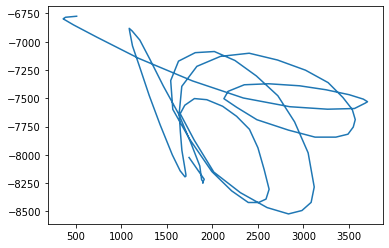

In [ ]:
#Display signature0v0
plt.plot(signature0_data["X"],-1*signature0_data["Y"])
plt.show()

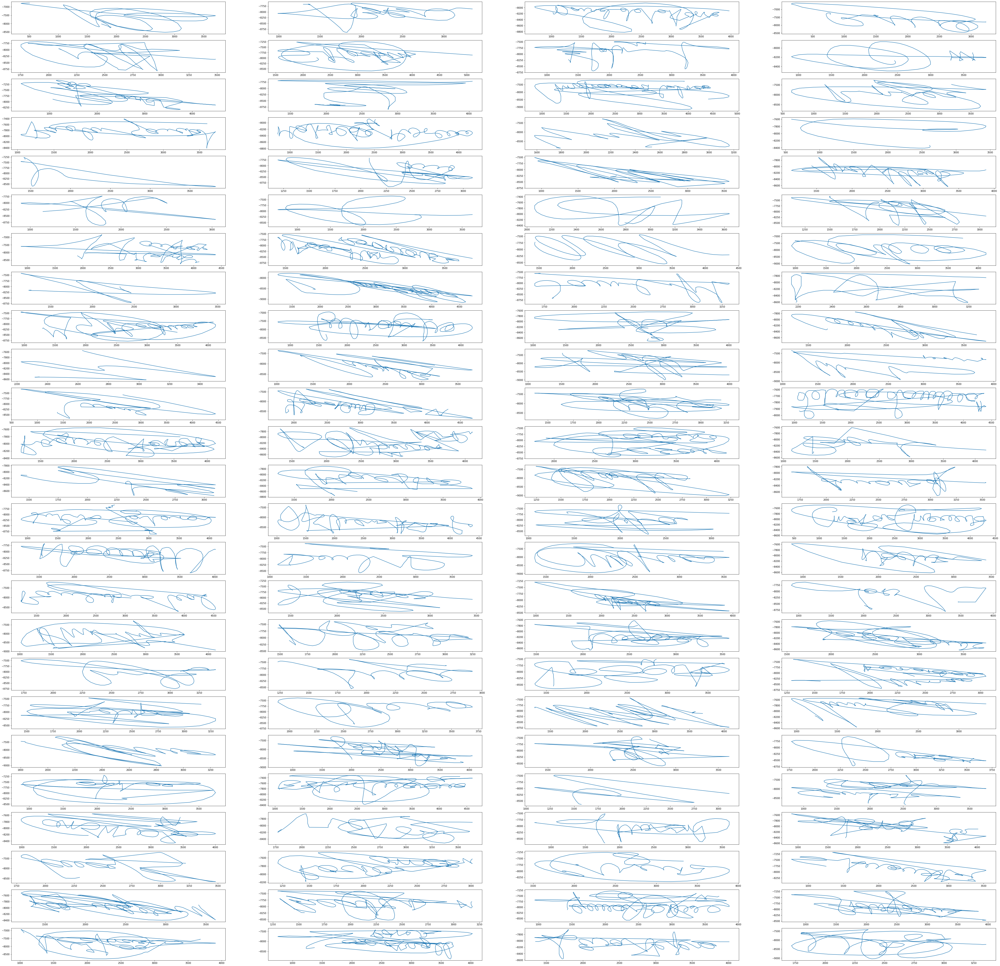

In [ ]:
#Display signatures0
plt.figure(figsize=(75, 75))
for i in range(100):
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, i+1)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

# III. Mesure de complexité et catégorisation 

In [ ]:
#Load datasets
complexite_4g = pd.read_csv('Complexité4G.csv',delimiter=";",header=0, index_col=0)
values_4g = complexite_4g.values

complexite_8g = pd.read_csv('Complexité8G.csv',delimiter=";",header=0, index_col=0)
values_8g = complexite_8g.values

complexite_24g = pd.read_csv('Complexité24G.csv',delimiter=";",header=0, index_col=0)
values_24g = complexite_24g.values

#Display dataset 4g
complexite_4g.head(100)

,1,2,3,4,5,6,7,8,9,10,...,16,17,18,19,20,21,22,23,24,25
1,33.196174,30.630899,31.620366,30.729677,31.315783,31.648257,30.743751,31.634842,31.707932,29.596445,...,30.034296,31.256953,29.305608,30.010867,31.094744,30.774858,29.950962,31.421825,31.139166,30.652187
2,29.986983,30.583706,27.625032,29.292256,29.669269,30.538943,29.909474,29.824111,29.922407,29.220199,...,28.576933,29.393262,28.996437,27.985681,29.939702,27.541448,29.462055,29.248769,28.552702,29.870580
3,30.667706,30.917278,30.731127,30.748777,30.855065,32.236980,31.065298,31.153569,30.932364,30.829701,...,30.687147,31.802889,30.838860,30.649592,31.223375,31.348533,31.315678,30.656321,30.705063,30.649945
4,31.983777,31.454306,31.904044,31.719449,31.710378,32.448793,30.467831,32.585240,32.659873,31.963733,...,31.797451,32.108550,30.755998,30.897831,32.106789,32.536209,32.524911,33.453109,32.442567,32.412028
5,28.689045,30.712718,30.181779,29.941101,29.958030,30.592751,31.319760,31.154500,30.637440,30.188860,...,30.073755,30.627108,30.416238,29.702336,29.707336,29.796852,30.210354,30.064297,30.341761,30.249106
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,32.187760,32.140702,32.456928,31.817168,30.643206,31.291725,31.144589,30.418554,32.123557,32.251920,...,30.673879,30.870871,31.795737,31.042203,32.301008,30.405458,30.485148,31.147491,31.515809,30.281642
97,31.073184,31.565909,31.811362,32.213600,31.403650,32.502255,32.564233,31.714854,32.092085,31.940199,...,31.440358,31.896856,32.045597,31.455625,32.081599,31.353365,33.634158,32.852364,32.287941,32.669984
98,32.434509,31.275699,32.909478,32.088216,31.435267,31.846224,32.834521,31.198978,31.341563,32.782125,...,30.771541,31.436798,31.257111,31.522443,32.085449,32.588523,31.566655,31.301503,31.172279,30.793073
99,29.326184,29.576708,30.354139,29.419829,31.336159,29.124390,29.510667,30.437898,29.660095,31.204000,...,29.382897,30.130084,29.868097,29.857901,29.578055,29.972003,31.176057,29.647203,29.768297,29.591255


In [ ]:
#Build datasets with mean complexities
complexite_moy_4g=[]
complexite_moy_8g=[]
complexite_moy_24g=[]
for i in range(100):
    complexite_moy_4g.append(np.mean(values_4g[i,:]))
    complexite_moy_8g.append(np.mean(values_8g[i,:]))   
    complexite_moy_24g.append(np.mean(values_24g[i,:]))
df_4g=pd.DataFrame({"Complexité moyenne":complexite_moy_4g})
df_8g=pd.DataFrame({"Complexité moyenne":complexite_moy_8g})
df_24g=pd.DataFrame({"Complexité moyenne":complexite_moy_24g})

# Première méthode de classification : classification ascendante hiérarchique

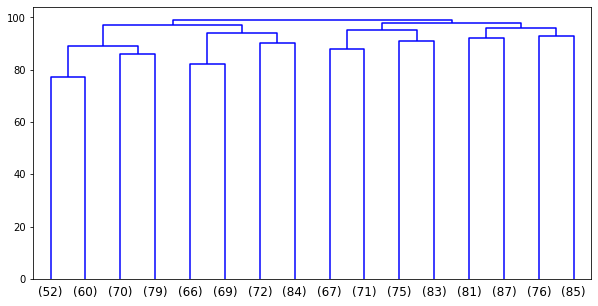

In [ ]:
#Implement hierarchical clustering for 4g
ward_4g = AgglomerativeClustering(linkage='ward', compute_full_tree=True,n_clusters=3).fit(df_4g)
#Display dendrogram
dendro_4g = [ ]
for a,b in ward_4g.children_:
    dendro_4g.append([a,b,float(len(dendro_4g)+1),len(dendro_4g)+1])
0
fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(1, 1, 1)
r_4g = dendrogram(dendro_4g, color_threshold=1, labels=df_4g.index,
               show_leaf_counts=True, ax=ax, orientation="top",truncate_mode='level', p=3)

In [ ]:
#Associate each value with its cluster for 4g
cluster_map_4g_hc = pd.DataFrame()
cluster_map_4g_hc['Cluster'] = ward_4g.labels_
cluster_map_4g_hc.head(100)

,Cluster
0,0
1,2
2,0
3,0
4,2
...,...
95,0
96,0
97,0
98,2


In [ ]:
#Calculate purcentage of people in each cluster for 4g
p0_4g_hc = len(cluster_map_4g_hc[cluster_map_4g_hc.Cluster == 0])/len(cluster_map_4g_hc)
p1_4g_hc = len(cluster_map_4g_hc[cluster_map_4g_hc.Cluster == 1])/len(cluster_map_4g_hc)
p2_4g_hc = len(cluster_map_4g_hc[cluster_map_4g_hc.Cluster == 2])/len(cluster_map_4g_hc)

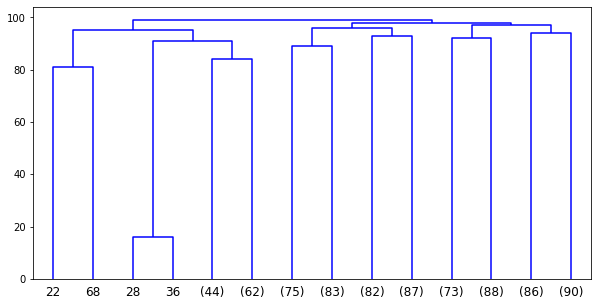

In [ ]:
#Implement hierarchical clustering for 8g
ward_8g = AgglomerativeClustering(linkage='ward', compute_full_tree=True,n_clusters=3).fit(df_8g)
#Display dendrogram for 8g
dendro_8g = [ ]
for a,b in ward_8g.children_:
    dendro_8g.append([a,b,float(len(dendro_8g)+1),len(dendro_8g)+1])
fig_8g = plt.figure(figsize=(10, 5))
ax_8g = fig_8g.add_subplot(1, 1, 1)
r_8g = dendrogram(dendro_8g, color_threshold=3, labels=df_8g.index,
               show_leaf_counts=True, ax=ax_8g, orientation="top",truncate_mode='level', p=3)

In [ ]:
#Associate each value with its cluster for 8g
cluster_map_8g_hc = pd.DataFrame()
cluster_map_8g_hc['Cluster'] = ward_8g.labels_

In [ ]:
#Calculate purcentage of people in each cluster for 8g
p0_8g_hc = len(cluster_map_8g_hc[cluster_map_8g_hc.Cluster == 0])/len(cluster_map_8g_hc)
p1_8g_hc = len(cluster_map_8g_hc[cluster_map_8g_hc.Cluster == 1])/len(cluster_map_8g_hc)
p2_8g_hc = len(cluster_map_8g_hc[cluster_map_8g_hc.Cluster == 2])/len(cluster_map_8g_hc)

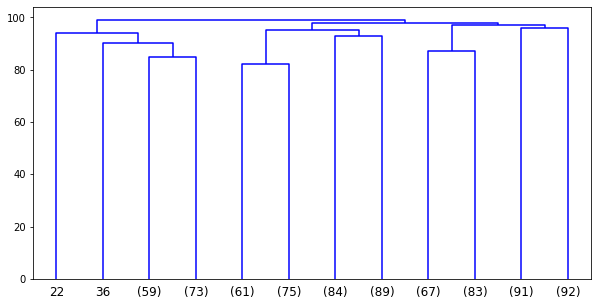

In [ ]:
#Implement hierarchical clustering for 24g
ward_24g = AgglomerativeClustering(linkage='ward', compute_full_tree=True,n_clusters=3).fit(df_24g)
#Display dendrogram for 24g
dendro_24g = [ ]
for a,b in ward_24g.children_:
    dendro_24g.append([a,b,float(len(dendro_24g)+1),len(dendro_24g)+1])
fig_24g = plt.figure(figsize=(10, 5))
ax_24g = fig_24g.add_subplot(1, 1, 1)
r_24g = dendrogram(dendro_24g, color_threshold=5, labels=df_24g.index,
               show_leaf_counts=True, ax=ax_24g, orientation="top",truncate_mode='level', p=3)

In [ ]:
#Associate each value with its cluster for 24g
cluster_map_24g_hc = pd.DataFrame()
cluster_map_24g_hc['Cluster'] = ward_24g.labels_

In [ ]:
#Calculate purcentage of people in each cluster for 24g
p0_24g_hc = len(cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 0])/len(cluster_map_24g_hc)
p1_24g_hc = len(cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 1])/len(cluster_map_24g_hc)
p2_24g_hc = len(cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 2])/len(cluster_map_24g_hc)

In [ ]:
pd.DataFrame({"4G":[p0_4g_hc,p1_4g_hc,p2_4g_hc],"8G":[p0_8g_hc,p1_8g_hc,p2_8g_hc],"24G":[p0_24g_hc,p1_24g_hc,p2_24g_hc]},index=["Cluster 0","Cluster 1","Cluster 2"])

,4G,8G,24G
Cluster 0,0.45,0.52,0.52
Cluster 1,0.20,0.08,0.07
Cluster 2,0.35,0.40,0.41


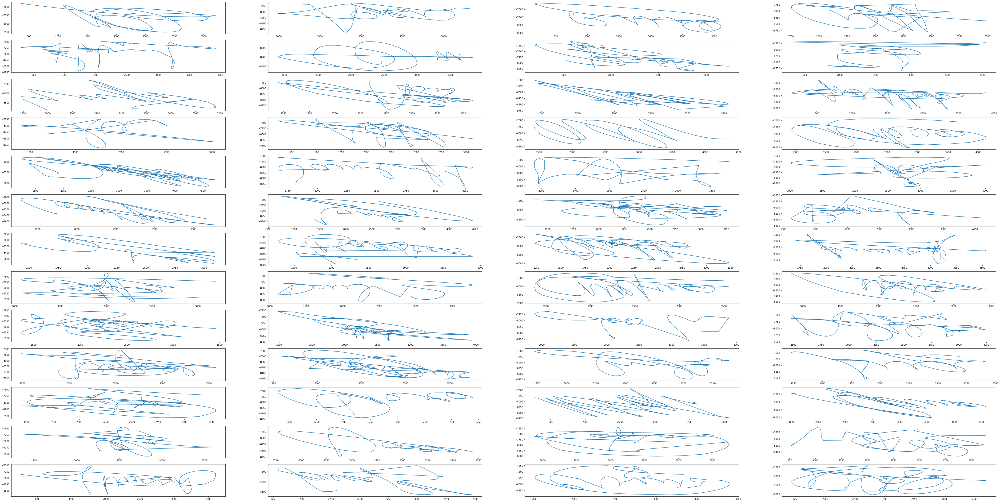

In [ ]:
#Display signatures0 in cluster 0 for 24g
c_0=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 0].index.values:
    c_0+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_0)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

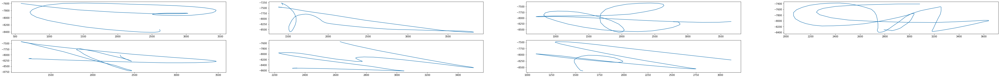

In [ ]:
#Display signatures0 in cluster 1 for 24g
c_1=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 1].index.values:
    c_1+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_1)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

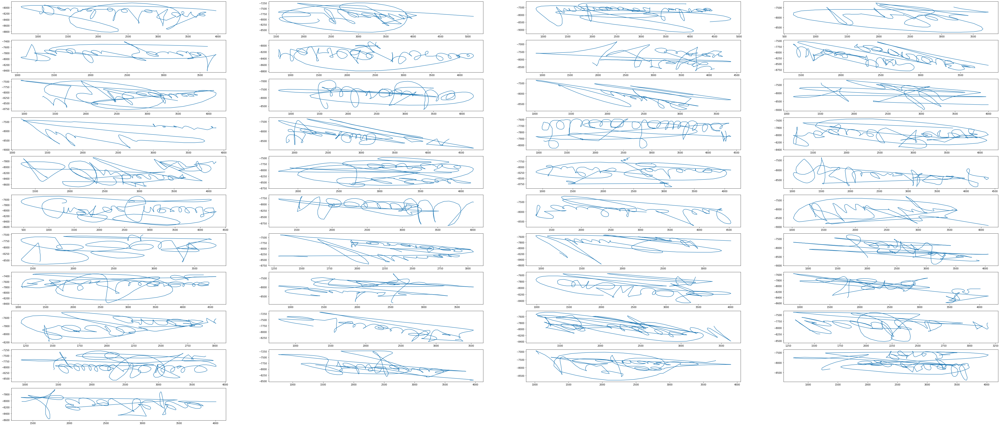

In [ ]:
#Display signatures0 in cluster 2 for 24g
c_2=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_hc[cluster_map_24g_hc.Cluster == 2].index.values:
    c_2+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_2)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

# Seconde méthode de classification : K-moyenne

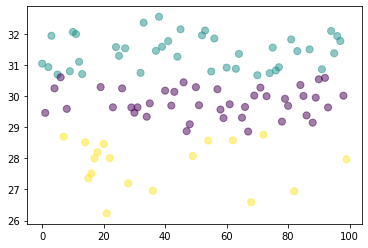

In [ ]:
#Implement and display kmeans method for 4g
kmeans_4g = KMeans(n_clusters=3, random_state=0).fit(df_4g)
plt.scatter(df_4g.index.values, df_4g['Complexité moyenne'], c= kmeans_4g.labels_.astype(float), s=50, alpha=0.5)

In [ ]:
#Associate each value with its cluster for 4g
cluster_map_4g_km = pd.DataFrame()
cluster_map_4g_km['Cluster'] = kmeans_4g.labels_
cluster_map_4g_km.head(100)

,Cluster
0,1
1,0
2,1
3,1
4,0
...,...
95,1
96,1
97,1
98,0


In [ ]:
#Calculate purcentage of people in each cluster for 4g
p0_4g_km = len(cluster_map_4g_km[cluster_map_4g_km.Cluster == 0])/len(cluster_map_4g_km)
p1_4g_km = len(cluster_map_4g_km[cluster_map_4g_km.Cluster == 1])/len(cluster_map_4g_km)
p2_4g_km = len(cluster_map_4g_km[cluster_map_4g_km.Cluster == 2])/len(cluster_map_4g_km)

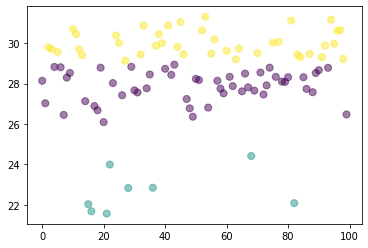

In [ ]:
#Implement and display kmeans method for 8g
kmeans_8g = KMeans(n_clusters=3, random_state=0).fit(df_8g)
plt.scatter(df_8g.index.values, df_8g['Complexité moyenne'], c= kmeans_8g.labels_.astype(float), s=50, alpha=0.5)

In [ ]:
#Associate each value with its cluster for 8g
cluster_map_8g_km = pd.DataFrame()
cluster_map_8g_km['Cluster'] = kmeans_8g.labels_

In [ ]:
#Calculate purcentage of people in each cluster for 8g
p0_8g_km = len(cluster_map_8g_km[cluster_map_8g_km.Cluster == 0])/len(cluster_map_8g_km)
p1_8g_km = len(cluster_map_8g_km[cluster_map_8g_km.Cluster == 1])/len(cluster_map_8g_km)
p2_8g_km = len(cluster_map_8g_km[cluster_map_8g_km.Cluster == 2])/len(cluster_map_8g_km)

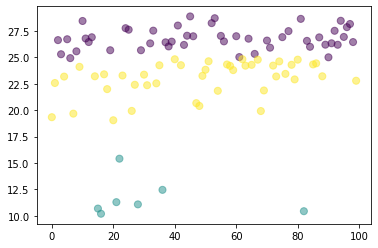

In [ ]:
#Implement and display kmeans method for 24g
kmeans_24g = KMeans(n_clusters=3, random_state=0).fit(df_24g)
plt.scatter(df_24g.index.values, df_24g['Complexité moyenne'], c= kmeans_24g.labels_.astype(float), s=50, alpha=0.5)

In [ ]:
#Associate each value with its cluster for 24g
cluster_map_24g_km = pd.DataFrame()
cluster_map_24g_km['Cluster'] = kmeans_24g.labels_

In [ ]:
#Calculate purcentage of people in each cluster for 24g
p0_24g_km = len(cluster_map_24g_km[cluster_map_24g_km.Cluster == 0])/len(cluster_map_24g_km)
p1_24g_km = len(cluster_map_24g_km[cluster_map_24g_km.Cluster == 1])/len(cluster_map_24g_km)
p2_24g_km = len(cluster_map_24g_km[cluster_map_24g_km.Cluster == 2])/len(cluster_map_24g_km)

In [ ]:
pd.DataFrame({"4G":[p0_4g_km,p1_4g_km,p2_4g_km],"8G":[p0_8g_km,p1_8g_km,p2_8g_km],"24G":[p0_24g_km,p1_24g_km,p2_24g_km]},index=["Cluster 0","Cluster 1","Cluster 2"])

,4G,8G,24G
Cluster 0,0.42,0.52,0.49
Cluster 1,0.40,0.08,0.07
Cluster 2,0.18,0.40,0.44


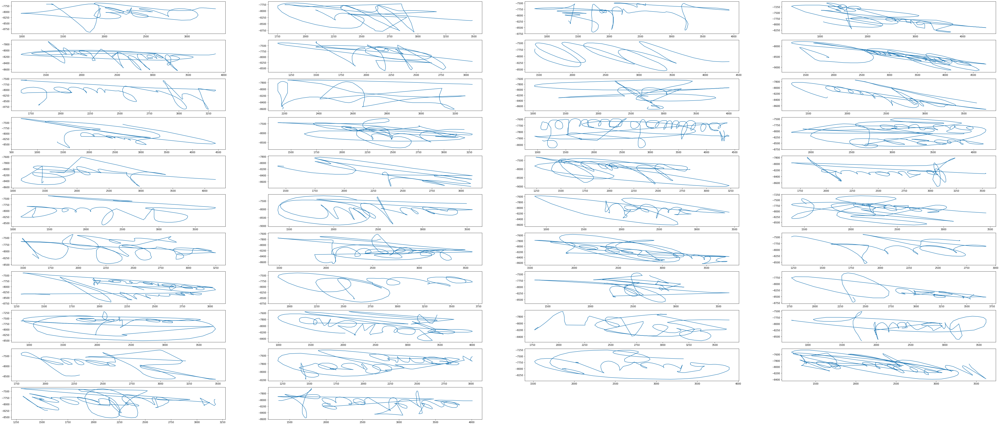

In [ ]:
#Display signatures0 in cluster 0 for 4g
c_0=0
plt.figure(figsize=(75, 75))
for i in cluster_map_4g_km[cluster_map_4g_km.Cluster == 0].index.values:
    c_0+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_0)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

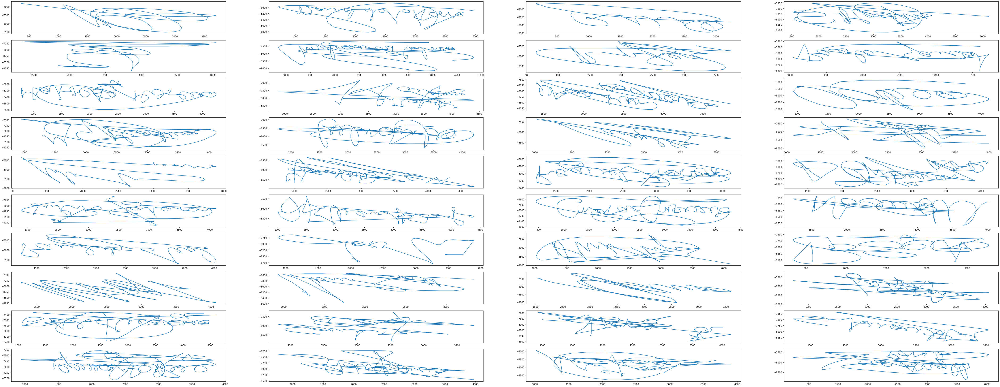

In [ ]:
#Display signatures0 in cluster 1 for 4g
c_1=0
plt.figure(figsize=(75, 75))
for i in cluster_map_4g_km[cluster_map_4g_km.Cluster == 1].index.values:
    c_1+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_1)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

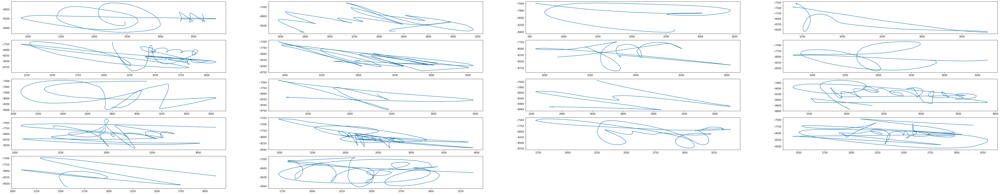

In [ ]:
#Display signatures0 in cluster 2 for 4g
c_2=0
plt.figure(figsize=(75, 75))
for i in cluster_map_4g_km[cluster_map_4g_km.Cluster == 2].index.values:
    c_2+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_2)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

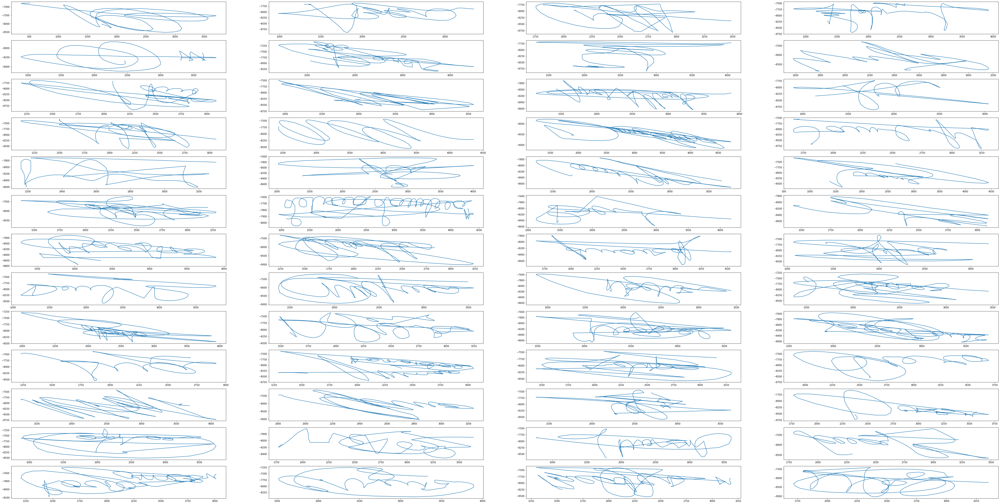

In [ ]:
#Display signatures0 in cluster 0 for 8g
c_0=0
plt.figure(figsize=(75, 75))
for i in cluster_map_8g_km[cluster_map_8g_km.Cluster == 0].index.values:
    c_0+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_0)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

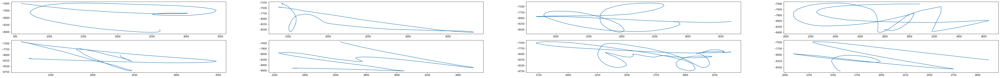

In [ ]:
#Display signatures0 in cluster 1 for 8g
c_1=0
plt.figure(figsize=(75, 75))
for i in cluster_map_8g_km[cluster_map_8g_km.Cluster == 1].index.values:
    c_1+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_1)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

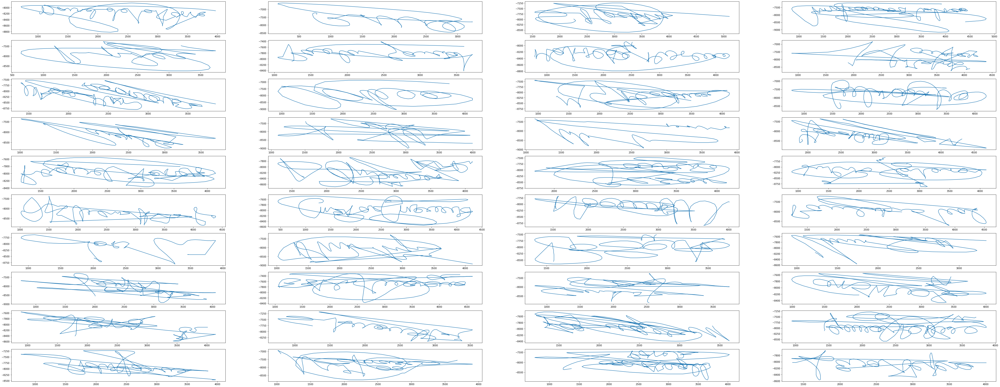

In [ ]:
#Display signatures0 in cluster 2 for 8g
c_2=0
plt.figure(figsize=(75, 75))
for i in cluster_map_8g_km[cluster_map_8g_km.Cluster == 2].index.values:
    c_2+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_2)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

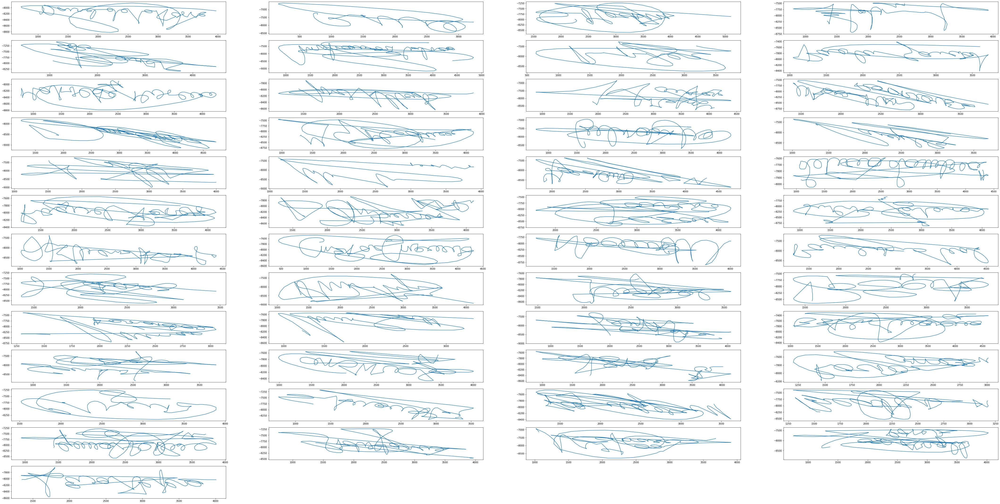

In [ ]:
#Display signatures0 in cluster 0 for 24g
c_0=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_km[cluster_map_24g_km.Cluster == 0].index.values:
    c_0+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_0)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

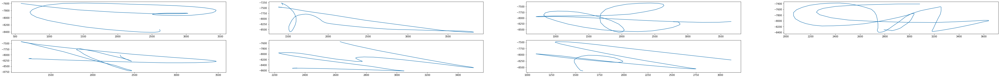

In [ ]:
#Display signatures0 in cluster 1 for 24g
c_1=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_km[cluster_map_24g_km.Cluster == 1].index.values:
    c_1+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_1)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

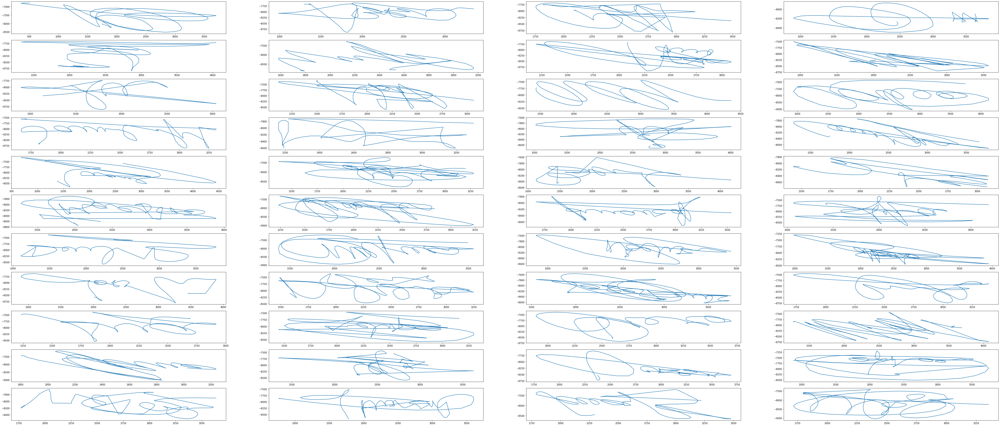

In [ ]:
#Display signatures0 in cluster 2 for 24g
c_2=0
plt.figure(figsize=(75, 75))
for i in cluster_map_24g_km[cluster_map_24g_km.Cluster == 2].index.values:
    c_2+=1
    signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
    signature_data.columns=['X','Y','P','Az','Al']
    plt.subplot(25, 4, c_2)
    plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
plt.show()

In [ ]:
inertie_intraclasses_4g=kmeans_4g.inertia_
inertie_intraclasses_8g=kmeans_8g.inertia_
inertie_intraclasses_24g=kmeans_24g.inertia_

pd.DataFrame({"Inertie intraclasse":[inertie_intraclasses_4g,inertie_intraclasses_8g,inertie_intraclasses_24g]},index=["4G","8G","24G"])

,Inertie intraclasse
4G,30.099420
8G,50.848206
24G,183.039971


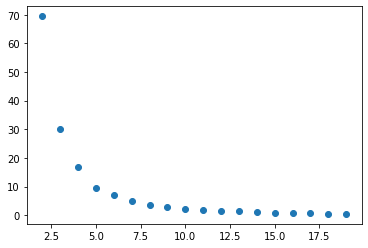

In [ ]:
#for each value of k, we can initialise k_means and use inertia to identify the sum of squared distances of samples to the nearest cluster centre

a=[]
for i in range(2,20):
    kmeans = cluster.KMeans(n_clusters=i) 
    kmeans.fit(df_4g) 
    a.append(kmeans.inertia_)
plt.scatter(range(2,20),a)

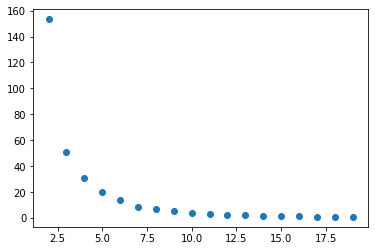

In [ ]:
#for each value of k, we can initialise k_means and use inertia to identify the sum of squared distances of samples to the nearest cluster centre

a=[]
for i in range(2,20):
    kmeans = cluster.KMeans(n_clusters=i) 
    kmeans.fit(df_8g) 
    a.append(kmeans.inertia_)
plt.scatter(range(2,20),a)

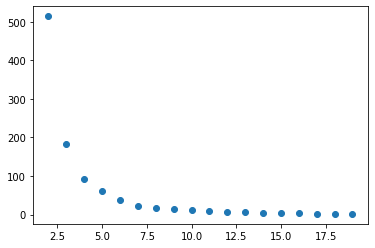

In [ ]:
#for each value of k, we can initialise k_means and use inertia to identify the sum of squared distances of samples to the nearest cluster centre

a=[]
for i in range(2,20):
    kmeans = cluster.KMeans(n_clusters=i) 
    kmeans.fit(df_24g) 
    a.append(kmeans.inertia_)
plt.scatter(range(2,20),a)

# III.3. Catégoriser les 2500 signatures authentiques en 3 catégories en utilisant la matrice « Complexité avec 24G (100x25) »

In [ ]:
complexite_24g_inter=complexite_24g.stack()
complexite_24g_stacked=pd.DataFrame({"Complexité":complexite_4g_inter})
X = [i for i in range(2500)]

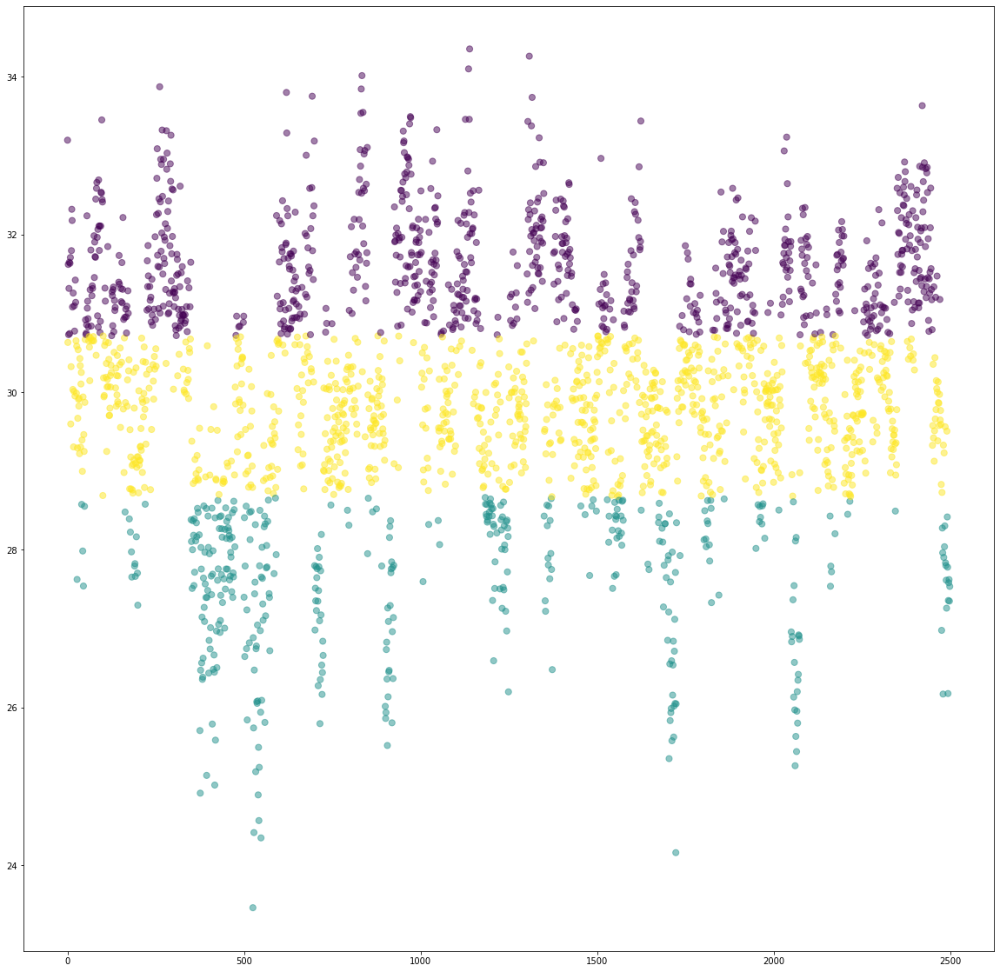

In [ ]:
#Implement and display kmeans method for 24g
plt.figure(figsize=(20, 20))
kmeans_24g = KMeans(n_clusters=3, random_state=0).fit(complexite_24g_stacked)
plt.scatter(X, complexite_24g_stacked['Complexité'], c= kmeans_24g.labels_.astype(float), s=50, alpha=0.5)

In [ ]:
#Associate each value with its cluster for 4g
cluster_map_24g = pd.DataFrame()
cluster_map_24g['Cluster'] = kmeans_24g.labels_
cluster_map_24g

,Cluster
0,0
1,2
2,0
3,0
4,0
...,...
2495,1
2496,1
2497,1
2498,1


In [ ]:
#Calculate purcentage of people's signature in each cluster for 24g
Purcentage = pd.DataFrame(index=["Cluster 0","Cluster 1","Cluster 2"])
for i in range(100):
    p0_24g = len(cluster_map_24g[i*25:(i+1)*25][cluster_map_24g[i*25:(i+1)*25].Cluster == 0])/25
    p1_24g = len(cluster_map_24g[i*25:(i+1)*25][cluster_map_24g[i*25:(i+1)*25].Cluster == 1])/25
    p2_24g = len(cluster_map_24g[i*25:(i+1)*25][cluster_map_24g[i*25:(i+1)*25].Cluster == 2])/25
    Purcentage[str(i)] = [p0_24g, p1_24g, p2_24g]
Purcentage.head(100)

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
Cluster 0,0.68,0.0,0.6,0.96,0.12,0.52,0.56,0.0,0.00,0.64,...,0.56,0.68,0.36,0.08,1.0,0.68,1.0,1.0,0.16,0.00
Cluster 1,0.00,0.2,0.0,0.00,0.00,0.00,0.04,0.4,0.04,0.00,...,0.00,0.00,0.00,0.04,0.0,0.00,0.0,0.0,0.00,0.76
Cluster 2,0.32,0.8,0.4,0.04,0.88,0.48,0.40,0.6,0.96,0.36,...,0.44,0.32,0.64,0.88,0.0,0.32,0.0,0.0,0.84,0.24


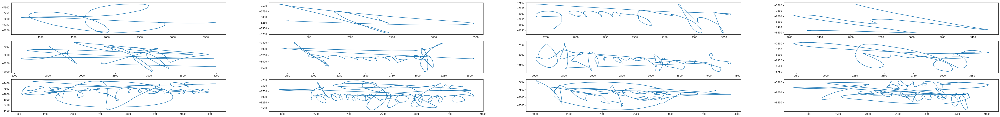

In [ ]:
#Display perfect signatures 
c=0
nb_0, nb_1, nb_2 = 0,0,0
plt.figure(figsize=(75, 75))
for i in Purcentage.columns.values:
    if  Purcentage[str(i)][0]==1.0 or Purcentage[str(i)][1]==1.0 or Purcentage[str(i)][2]==1.0 :
        c+=1
        signature_data = pd.read_csv("./Base de données/" + str(i) + "v0.txt",delimiter=' ', header=None)
        signature_data.columns=['X','Y','P','Az','Al']
        plt.subplot(25, 4, c)
        plt.plot(signature_data[signature_data.P != 0]["X"],-1*signature_data[signature_data.P != 0]["Y"])
        if Purcentage[str(i)][0]==1.0 : 
            nb_0+=1
        if Purcentage[str(i)][1]==1.0 : 
            nb_1+=1
        if Purcentage[str(i)][2]==1.0 : 
            nb_2+=1
plt.show()

In [ ]:
#Calculate purcentage of perfect signature per cluster
p0 = 25*nb_0/len(cluster_map_24g[cluster_map_24g.Cluster == 0])
p1 = 25*nb_1/len(cluster_map_24g[cluster_map_24g.Cluster == 1])
p2 = 25*nb_2/len(cluster_map_24g[cluster_map_24g.Cluster == 2])

pd.DataFrame({"Pourcentage":[p0*100,p1*100,p2*100]},index=["Cluster 0","Cluster 1","Cluster 2"])

,Pourcentage
Cluster 0,15.991471
Cluster 1,22.988506
Cluster 2,4.436557


# III.4. Apprentissage et généralisation en utilisant la matrice « Complexité avec 24G (100x25) » (Livrable 4)

In [ ]:
complexite_24g_half=complexite_24g[0:50]

complexite_24g_inter_half=complexite_24g_half.stack()
complexite_24g_stacked_half=pd.DataFrame({"Complexité":complexite_24g_inter_half})
X_half = [i for i in range(1250)]

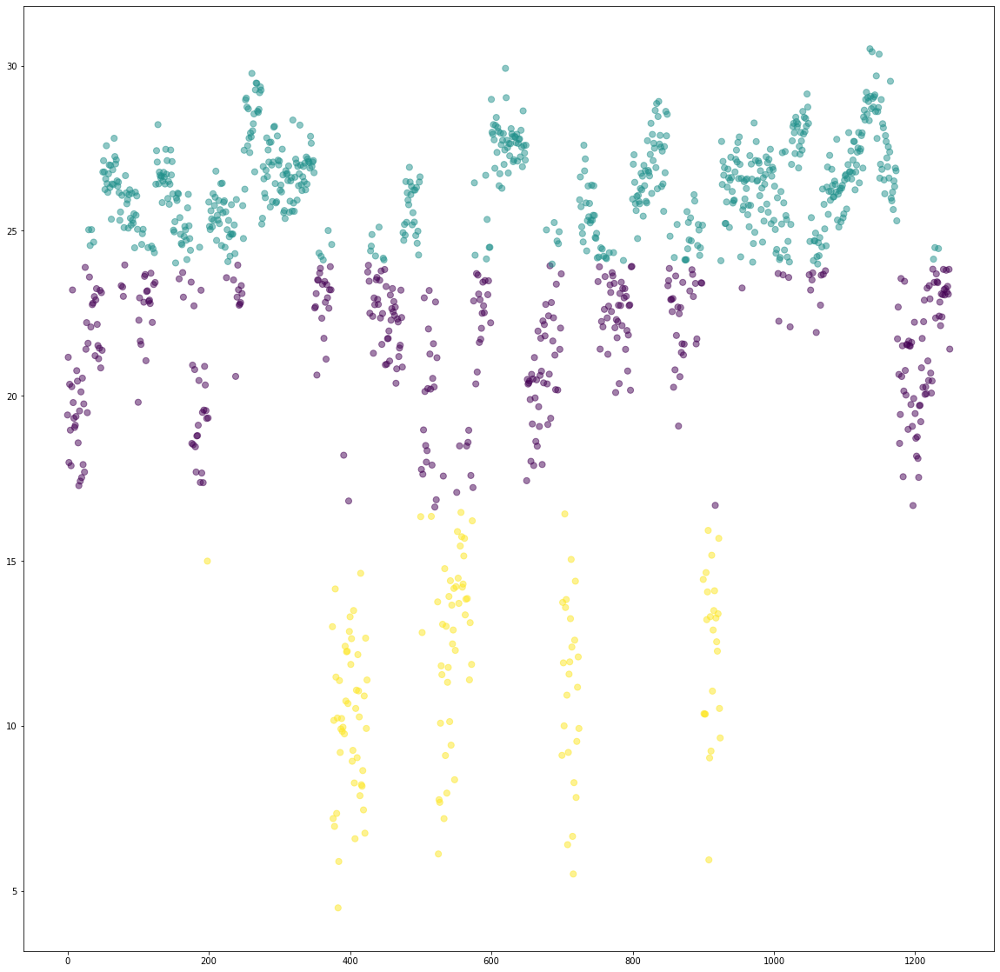

In [ ]:
#Implement and display kmeans method for 24g
plt.figure(figsize=(20, 20))
kmeans_24g = KMeans(n_clusters=3, random_state=0).fit(complexite_24g_stacked_half)
plt.scatter(X_half, complexite_24g_stacked_half['Complexité'], c= kmeans_24g.labels_.astype(float), s=50, alpha=0.5)

In [ ]:
knn=KNeighborsClassifier(n_neighbors=25)
knn.fit(complexite_24g_half)

NameError: ignored